conda install -c conda-forge requests six pandas numpy osmnet pandana matplotlib geopy cartopy pyyaml scikit-learn

In [2]:
conda install urbanaccess -c conda-forge

Solving environment: done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [3]:
conda install -c conda-forge pyepsg

Solving environment: done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [4]:
import matplotlib

import pandas as pd
import cartopy.crs as ccrs
import cartopy
import matplotlib.pyplot as plt
import pandana as pdna
import osmnet as osm
from pandana.loaders import osm
import time
import pyepsg
import h5py

import urbanaccess as ua
from urbanaccess.config import settings
from urbanaccess.gtfsfeeds import feeds
from urbanaccess import gtfsfeeds
from urbanaccess.gtfs.gtfsfeeds_dataframe import gtfsfeeds_dfs
from urbanaccess.network import ua_network, load_network

from simpledbf import Dbf5

%matplotlib inline

In [5]:
settings.to_dict()

{'data_folder': 'data',
 'logs_folder': 'logs',
 'log_file': True,
 'log_console': False,
 'log_name': 'urbanaccess',
 'log_filename': 'urbanaccess',
 'txt_encoding': 'utf-8',
 'gtfs_api': {'gtfsdataexch': 'http://www.gtfs-data-exchange.com/api/agencies?format=csv'}}

In [6]:
settings.log_console = True

In [7]:
settings.log_console = False

In [8]:
feeds.to_dict()

{'gtfs_feeds': {}}

In [9]:
# GTFS feeds can be added using custom URLs by adding a dictionary with the key as the name of the transit agency
feeds.add_feed(add_dict={'MTA New York City Transit Authority': 'http://web.mta.info/developers/data/nyct/subway/google_transit.zip'})
feeds.add_feed(add_dict={'MTA Bronx Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_bronx.zip'})
feeds.add_feed(add_dict={'MTA Brooklyn Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_brooklyn.zip'})
feeds.add_feed(add_dict={'MTA Manhattan Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_manhattan.zip'})
feeds.add_feed(add_dict={'MTA Queens Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_queens.zip'})
feeds.add_feed(add_dict={'MTA Staten Island Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_staten_island.zip'})

Added 1 feeds to gtfs_feeds: {'MTA New York City Transit Authority': 'http://web.mta.info/developers/data/nyct/subway/google_transit.zip'}
Added 1 feeds to gtfs_feeds: {'MTA Bronx Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_bronx.zip'}
Added 1 feeds to gtfs_feeds: {'MTA Brooklyn Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_brooklyn.zip'}
Added 1 feeds to gtfs_feeds: {'MTA Manhattan Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_manhattan.zip'}
Added 1 feeds to gtfs_feeds: {'MTA Queens Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_queens.zip'}
Added 1 feeds to gtfs_feeds: {'MTA Staten Island Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_staten_island.zip'}


In [10]:
# List the GTFS feeds in feed object ready to download
feeds.to_dict()

{'gtfs_feeds': {'MTA New York City Transit Authority': 'http://web.mta.info/developers/data/nyct/subway/google_transit.zip',
  'MTA Bronx Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_bronx.zip',
  'MTA Brooklyn Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_brooklyn.zip',
  'MTA Manhattan Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_manhattan.zip',
  'MTA Queens Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_queens.zip',
  'MTA Staten Island Transit Bus': 'http://web.mta.info/developers/data/nyct/bus/google_transit_staten_island.zip'}}

In [11]:
# Download function to download all feeds in the feeds object at once. 
gtfsfeeds.download()

6 GTFS feed(s) will be downloaded here: data/gtfsfeed_zips
MTA New York City Transit Authority GTFS feed downloaded successfully. Took 3.58 seconds for 4,648,447.0KB
MTA Bronx Transit Bus GTFS feed downloaded successfully. Took 5.26 seconds for 8,786,764.0KB
MTA Brooklyn Transit Bus GTFS feed downloaded successfully. Took 11.50 seconds for 16,590,008.0KB
MTA Manhattan Transit Bus GTFS feed downloaded successfully. Took 4.71 seconds for 7,613,854.0KB
MTA Queens Transit Bus GTFS feed downloaded successfully. Took 4.72 seconds for 8,260,856.0KB
MTA Staten Island Transit Bus GTFS feed downloaded successfully. Took 3.65 seconds for 6,040,530.0KB
GTFS feed download completed. Took 33.41 seconds
MTA Staten Island Transit Bus.zip successfully extracted to: data/gtfsfeed_text/MTA Staten Island Transit Bus
MTA Brooklyn Transit Bus.zip successfully extracted to: data/gtfsfeed_text/MTA Brooklyn Transit Bus
MTA New York City Transit Authority.zip successfully extracted to: data/gtfsfeed_text/MTA Ne

In [12]:
# After downloading the data, load GTFS feeds into a combined network of Pandas DataFrames. 
# One or multiple feeds inside a root folder can be specified using the gtfsfeed_path paramater.
# Setting a bounding box limits GTFS data to specified area (NYC)

validation = True
verbose = True
# bbox for New York City
bbox = (-74.25909,40.477399,-73.700181,40.916178)
remove_stops_outsidebbox = True
append_definitions = True

loaded_feeds = ua.gtfs.load.gtfsfeed_to_df(gtfsfeed_path='/Users/radleyciego/data/gtfsfeed_text/',
                                           validation=validation,
                                           verbose=verbose,
                                           bbox=bbox,
                                           remove_stops_outsidebbox=remove_stops_outsidebbox,
                                           append_definitions=append_definitions)

Checking GTFS text file header whitespace... Reading files using encoding: utf-8 set in configuration.
GTFS text file header whitespace check completed. Took 1.53 seconds
--------------------------------
Processing GTFS feed: MTA Bronx Transit Bus
The unique agency id: mta_new_york_city_transit was generated using the name of the agency in the agency.txt file.
Unique agency id operation complete. Took 0.05 seconds
Unique GTFS feed id operation complete. Took 0.01 seconds
No GTFS feed stops were found to be outside the bounding box coordinates
MTA Bronx Transit Bus GTFS feed stops: coordinates are in northwest hemisphere. Latitude = North (90); Longitude = West (-90).
Appended route type to stops
Appended route type to stop_times
--------------------------------
--------------------------------
Processing GTFS feed: MTA Staten Island Transit Bus
The unique agency id: mta_new_york_city_transit was generated using the name of the agency in the agency.txt file.
Unique agency id operation c

In [13]:
# The feeds output, now a global urbanaccess_gtfs_df object, can be accessed with the specified variable loaded_feeds.
loaded_feeds.stops.head()

,stop_id,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station,unique_agency_id,unique_feed_id,route_type,stop_code,location_type_desc
0,100014,BEDFORD PK BL/GRAND CONCOURSE,NaN,40.872562,-73.888156,NaN,NaN,0,NaN,mta_new_york_city_transit,mta_bronx_transit_bus_1,3.0,NaN,stop
1,100017,PAUL AV/W 205 ST,NaN,40.876836,-73.889710,NaN,NaN,0,NaN,mta_new_york_city_transit,mta_bronx_transit_bus_1,3.0,NaN,stop
2,100018,PAUL AV/W MOSHOLU PY S,NaN,40.880392,-73.886081,NaN,NaN,0,NaN,mta_new_york_city_transit,mta_bronx_transit_bus_1,3.0,NaN,stop
3,100019,GRAND CONCOURSE/E 138 ST,NaN,40.813496,-73.929489,NaN,NaN,0,NaN,mta_new_york_city_transit,mta_bronx_transit_bus_1,3.0,NaN,stop
4,100020,GRAND CONCOURSE/E 144 ST,NaN,40.816812,-73.928001,NaN,NaN,0,NaN,mta_new_york_city_transit,mta_bronx_transit_bus_1,3.0,NaN,stop


In [14]:
loaded_feeds.stops.unique_agency_id.unique()

array(['mta_new_york_city_transit'], dtype=object)

<AxesSubplot:xlabel='stop_lon', ylabel='stop_lat'>

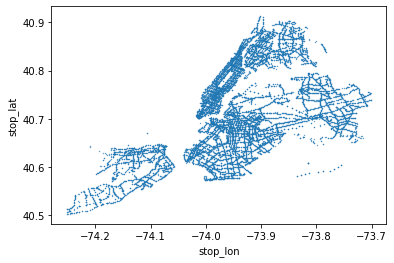

In [15]:
# View the transit stop locations
loaded_feeds.stops.plot(kind='scatter', x='stop_lon', y='stop_lat', s=0.1)

In [16]:
loaded_feeds.routes.head()

,route_id,agency_id,route_short_name,route_long_name,route_desc,route_type,route_color,route_text_color,unique_agency_id,unique_feed_id,route_url,route_type_desc
0,B1,MTA NYCT,B1,Bay Ridge - Manhattan Beach,via 86th St / Ocean Pkwy,3,00AEEF,FFFFFF,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN,Bus
1,B11,MTA NYCT,B11,Sunset Park - Midwood,via 49th & 50th St / Avenue J,3,006CB7,FFFFFF,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN,Bus
2,B12,MTA NYCT,B12,Lefferts Gardens - East New York,via Clarkson Av / Empire Blvd / East New York Av,3,6CBE45,FFFFFF,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN,Bus
3,B13,MTA NYCT,B13,Spring Creek - Wyckoff Hospital,via Crescent St / Jamaica Av / Wyckoff Av,3,FAA61A,FFFFFF,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN,Bus
4,B14,MTA NYCT,B14,Spring Creek - Crown Heights,via Sutter Av / Pitkin Av,3,00AEEF,FFFFFF,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN,Bus


In [17]:
loaded_feeds.stop_times.head()

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,pickup_type,drop_off_type,unique_agency_id,unique_feed_id,route_type,stop_headsign,shape_dist_traveled,pickup_type_desc,drop_off_type_desc,departure_time_sec
0,GH_B2-Weekday-BM-143500_BX41_901,23:55:00,23:55:00,104525,1,0,0,mta_new_york_city_transit,mta_bronx_transit_bus_1,3,NaN,NaN,Regularly Scheduled,Regularly Scheduled,86100
1,GH_B2-Weekday-BM-143500_BX41_901,23:56:44,23:56:44,102795,2,0,0,mta_new_york_city_transit,mta_bronx_transit_bus_1,3,NaN,NaN,Regularly Scheduled,Regularly Scheduled,86204
2,GH_B2-Weekday-BM-143500_BX41_901,23:58:58,23:58:58,102796,3,0,0,mta_new_york_city_transit,mta_bronx_transit_bus_1,3,NaN,NaN,Regularly Scheduled,Regularly Scheduled,86338
3,GH_B2-Weekday-BM-143500_BX41_901,23:59:50,23:59:50,104560,4,0,0,mta_new_york_city_transit,mta_bronx_transit_bus_1,3,NaN,NaN,Regularly Scheduled,Regularly Scheduled,86390
4,GH_B2-Weekday-BM-143500_BX41_901,24:00:49,24:00:49,102798,5,0,0,mta_new_york_city_transit,mta_bronx_transit_bus_1,3,NaN,NaN,Regularly Scheduled,Regularly Scheduled,86449


In [18]:
loaded_feeds.trips.head()

,route_id,service_id,trip_id,trip_headsign,direction_id,shape_id,unique_agency_id,unique_feed_id,block_id
0,BX41,GH_B2-Weekday-BM,GH_B2-Weekday-BM-143500_BX41_901,THE HUB 150 ST via WEBSTER,1,BX410049,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN
1,BX41,GH_B2-Weekday,GH_B2-Weekday-003900_BX41_901,WILLAMSBRIDGE GUN HILL RD via WEBSTER,0,BX410047,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN
2,BX39,GH_B2-Weekday,GH_B2-Weekday-007600_BX41_901,WAKEFIELD 241 ST via WHITE PLS RD,0,BX390019,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN
3,BX39,GH_B2-Weekday,GH_B2-Weekday-009500_BX41_901,GUN HILL RD,1,BX390167,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN
4,BX41,GH_B2-Weekday,GH_B2-Weekday-011300_BX41_901,THE HUB 150 ST via WEBSTER,1,BX410049,mta_new_york_city_transit,mta_bronx_transit_bus_1,NaN


In [19]:
loaded_feeds.calendar.head()

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date,unique_agency_id,unique_feed_id
0,GH_B2-Sunday,0,0,0,0,0,0,1,20220327,20220619,mta_new_york_city_transit,mta_bronx_transit_bus_1
1,GH_B2-Weekday-SDon,1,1,1,1,1,0,0,20220328,20220624,mta_new_york_city_transit,mta_bronx_transit_bus_1
2,GH_B2-Weekday-SDon-BM,1,1,1,1,0,0,1,20220327,20220623,mta_new_york_city_transit,mta_bronx_transit_bus_1
3,GH_B2-Saturday,0,0,0,0,0,1,0,20220402,20220625,mta_new_york_city_transit,mta_bronx_transit_bus_1
4,KB_B2-Sunday,0,0,0,0,0,0,1,20220327,20220619,mta_new_york_city_transit,mta_bronx_transit_bus_1


In [20]:
# Create a time weighted graph during Monday morning peak period
ua.gtfs.network.create_transit_net(gtfsfeeds_dfs=loaded_feeds,
                                   day='monday',
                                   timerange=['07:00:00', '10:00:00'],
                                   calendar_dates_lookup=None)

Using calendar to extract service_ids to select trips.
56 service_ids were extracted from calendar
63,885 trip(s) 39.22 percent of 162,875 total trip records were found in calendar for GTFS feed(s): ['mta bronx transit bus', 'mta staten island transit bus', 'mta queens transit bus', 'mta new york city transit authority', 'mta brooklyn transit bus', 'mta manhattan transit bus']
NOTE: If you expected more trips to have been extracted and your GTFS feed(s) have a calendar_dates file, consider utilizing the calendar_dates_lookup parameter in order to add additional trips based on information inside of calendar_dates. This should only be done if you know the corresponding GTFS feed is using calendar_dates instead of calendar to specify service_ids. When in doubt do not use the calendar_dates_lookup parameter.
63,885 of 162,875 total trips were extracted representing calendar day: monday. Took 0.30 seconds
There are no departure time records missing from trips following the specified schedul

In [21]:
urbanaccess_net = ua.network.ua_network

In [22]:
urbanaccess_net.transit_edges.head()

,node_id_from,node_id_to,weight,unique_agency_id,unique_trip_id,sequence,id,route_type,unique_route_id,net_type
0,104N_mta_new_york_city_transit,103N_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1,1_mta_new_york_city_transit,transit
1,103N_mta_new_york_city_transit,101N_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,2,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1,1_mta_new_york_city_transit,transit
2,135S_mta_new_york_city_transit,136S_mta_new_york_city_transit,1.0,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1,1_mta_new_york_city_transit,transit
3,136S_mta_new_york_city_transit,137S_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,2,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1,1_mta_new_york_city_transit,transit
4,137S_mta_new_york_city_transit,138S_mta_new_york_city_transit,1.0,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,3,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1,1_mta_new_york_city_transit,transit


In [23]:
urbanaccess_net.transit_nodes.head()

,x,y,unique_agency_id,route_type,stop_id,stop_name,parent_station,stop_code,zone_id,location_type,net_type
node_id,,,,,,,,,,,
100014_mta_new_york_city_transit,-73.888156,40.872562,mta_new_york_city_transit,3.0,100014,BEDFORD PK BL/GRAND CONCOURSE,NaN,NaN,NaN,0,transit
100017_mta_new_york_city_transit,-73.889710,40.876836,mta_new_york_city_transit,3.0,100017,PAUL AV/W 205 ST,NaN,NaN,NaN,0,transit
100018_mta_new_york_city_transit,-73.886081,40.880392,mta_new_york_city_transit,3.0,100018,PAUL AV/W MOSHOLU PY S,NaN,NaN,NaN,0,transit
100019_mta_new_york_city_transit,-73.929489,40.813496,mta_new_york_city_transit,3.0,100019,GRAND CONCOURSE/E 138 ST,NaN,NaN,NaN,0,transit
100021_mta_new_york_city_transit,-73.927096,40.818856,mta_new_york_city_transit,3.0,100021,GRAND CONCOURSE/E 149 ST,NaN,NaN,NaN,0,transit


<AxesSubplot:xlabel='x', ylabel='y'>

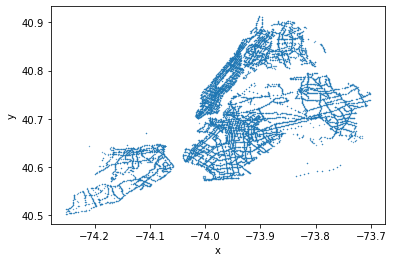

In [24]:
urbanaccess_net.transit_nodes.plot(kind='scatter', x='x', y='y', s=0.1)

In [25]:
network = ua.network.load_network(dir='data', filename='nyc_net.h5')
network

Successfully read store: data/nyc_net.h5 with the following keys: ['/edges', '/nodes']
Successfully read store: data/nyc_net.h5 with the following keys: ['/edges', '/nodes']


In [26]:
# Download OpenStreetMap pedestrian street network data using New York City bounding box
nodes, edges = ua.osm.load.ua_network_from_bbox(bbox=(-74.25909,40.477399,-73.700181,40.916178),
                                                remove_lcn=True) 

Requesting network data within bounding box from Overpass API in 1 request(s)
Posting to http://www.overpass-api.de/api/interpreter with timeout=180, "{'data': '[out:json][timeout:180];(way["highway"]["highway"!~"motor|proposed|construction|abandoned|platform|raceway"]["foot"!~"no"]["pedestrians"!~"no"](40.47739900,-74.25909000,40.91617800,-73.70018100);>;);out;'}"
Downloaded 185,258.8KB from www.overpass-api.de in 21.66 seconds
Downloaded OSM network data within bounding box from Overpass API in 1 request(s) and 25.79 seconds
Returning OSM data with 1,086,444 nodes and 291,401 ways...
Edge node pairs completed. Took 267.47 seconds
Returning processed graph with 404,466 nodes and 1,217,672 edges...
Completed OSM data download and Pandana node and edge table creation in 306.13 seconds
checking for low connectivity nodes...
Generating contraction hierarchies with 8 threads.
Setting CH node vector of size 404466
Setting CH edge vector of size 1259704
Range graph removed 1322362 edges of 2

In [27]:
# Create travel time weighted pedestrian network. Pedestrian travel speed set at 3mph. osm_edges and osm_nodes will
# hold nodes and edges, respectively.
ua.osm.network.create_osm_net(osm_edges=edges,
                              osm_nodes=nodes,
                              travel_speed_mph=3)

Created OSM network with travel time impedance using a travel speed of 3 MPH. Took 0.03 seconds


In [28]:
# Visualize OSM network nodes
urbanaccess_net.osm_nodes.head()

,x,y,id,net_type
id,,,,
30807308,-73.962176,40.792024,30807308,walk
30807314,-73.963576,40.790720,30807314,walk
30807351,-73.966988,40.785589,30807351,walk
30978747,-73.973425,40.774267,30978747,walk
30978752,-73.974360,40.774776,30978752,walk


In [29]:
# Visualize OSM network edges
urbanaccess_net.osm_edges.head()

from          to   distance               name  \
278630910  6933321234   278630910  6933321234  16.146700       Boerum Place   
6933321234 278630910   6933321234   278630910  16.146700       Boerum Place   
           4209410680  6933321234  4209410680  75.472688       Boerum Place   
4209410680 6933321234  4209410680  6933321234  75.472688       Boerum Place   
4205830390 3602678205  4205830390  3602678205  27.601179  West 106th Street   

                       ref    highway service bridge tunnel access  ... lanes  \
278630910  6933321234  NaN    primary     NaN    NaN    NaN    NaN  ...     3   
6933321234 278630910   NaN    primary     NaN    NaN    NaN    NaN  ...     3   
           4209410680  NaN    primary     NaN    NaN    NaN    NaN  ...     3   
4209410680 6933321234  NaN    primary     NaN    NaN    NaN    NaN  ...     3   
4205830390 3602678205  NaN  secondary     NaN    NaN    NaN    NaN  ...   NaN   

                      maxspeed          hgv  hov area width est_width  \
278630910  6933321234   25 mph  destination  NaN  NaN   NaN       NaN   
6933321234 278630910    25 mph  destination  NaN  NaN   NaN       NaN   
           4209410680   25 mph  destination  NaN  NaN   NaN       NaN   
4209410680 6933321234   25 mph  destination  NaN  NaN   NaN       NaN   
4205830390 3602678205      NaN  destination  NaN  NaN   NaN       NaN   

                      junction    weight net_type  
278630910  6933321234      NaN  0.200662     walk  
6933321234 278630910       NaN  0.200662     walk  
           4209410680      NaN  0.937933     walk  
4209410680 6933321234      NaN  0.937933     walk  
4205830390 3602678205      NaN  0.343012     walk  

[5 rows x 22 columns]

<AxesSubplot:xlabel='x', ylabel='y'>

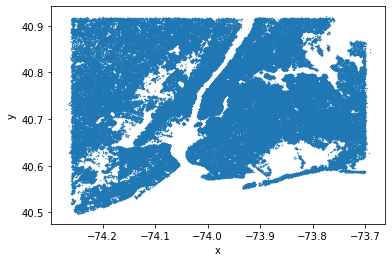

In [30]:
urbanaccess_net.osm_nodes.plot(kind='scatter', x='x', y='y', s=0.1)

In [31]:
# Integrate pedestrian and transit networks
ua.network.integrate_network(urbanaccess_network=urbanaccess_net,
                             headways=False)

Loaded UrbanAccess network components comprised of:
     Transit: 13,513 nodes and 440,063 edges;
     OSM: 403,317 nodes and 1,215,368 edges
Connector edges between the OSM and transit network nodes successfully completed. Took 3.89 seconds
Edge and node tables formatted for Pandana with integer node ids: id_int, to_int, and from_int. Took 13.04 seconds
Network edge and node network integration completed successfully resulting in a total of 416,830 nodes and 1,719,560 edges:
     Transit: 13,513 nodes 440,063 edges;
     OSM: 403,317 nodes 1,215,368 edges; and
     OSM/Transit connector: 27,026 edges.


In [32]:
urbanaccess_net.net_nodes.head()

,id,x,y,unique_agency_id,route_type,stop_id,stop_name,parent_station,stop_code,zone_id,location_type,net_type
id_int,,,,,,,,,,,,
1,100014_mta_new_york_city_transit,-73.888156,40.872562,mta_new_york_city_transit,3.0,100014,BEDFORD PK BL/GRAND CONCOURSE,NaN,NaN,NaN,0.0,transit
2,100017_mta_new_york_city_transit,-73.889710,40.876836,mta_new_york_city_transit,3.0,100017,PAUL AV/W 205 ST,NaN,NaN,NaN,0.0,transit
3,100018_mta_new_york_city_transit,-73.886081,40.880392,mta_new_york_city_transit,3.0,100018,PAUL AV/W MOSHOLU PY S,NaN,NaN,NaN,0.0,transit
4,100019_mta_new_york_city_transit,-73.929489,40.813496,mta_new_york_city_transit,3.0,100019,GRAND CONCOURSE/E 138 ST,NaN,NaN,NaN,0.0,transit
5,100021_mta_new_york_city_transit,-73.927096,40.818856,mta_new_york_city_transit,3.0,100021,GRAND CONCOURSE/E 149 ST,NaN,NaN,NaN,0.0,transit


In [33]:
urbanaccess_net.net_edges.head()

,from,to,weight,unique_agency_id,unique_trip_id,sequence,edge_id,route_type,unique_route_id,net_type,...,lanes,maxspeed,hgv,hov,area,width,est_width,junction,from_int,to_int
0,104N_mta_new_york_city_transit,103N_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1.0,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6098,6096
1,103N_mta_new_york_city_transit,101N_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,2.0,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6096,6094
2,135S_mta_new_york_city_transit,136S_mta_new_york_city_transit,1.0,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6159,6161
3,136S_mta_new_york_city_transit,137S_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,2.0,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6161,6163
4,137S_mta_new_york_city_transit,138S_mta_new_york_city_transit,1.0,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,3.0,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6163,6165


In [34]:
urbanaccess_net.net_edges[urbanaccess_net.net_edges['net_type'] == 'transit'].head()

,from,to,weight,unique_agency_id,unique_trip_id,sequence,edge_id,route_type,unique_route_id,net_type,...,lanes,maxspeed,hgv,hov,area,width,est_width,junction,from_int,to_int
0,104N_mta_new_york_city_transit,103N_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1.0,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6098,6096
1,103N_mta_new_york_city_transit,101N_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,2.0,AFA21GEN-1091-Weekday-00_037150_1..N03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6096,6094
2,135S_mta_new_york_city_transit,136S_mta_new_york_city_transit,1.0,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6159,6161
3,136S_mta_new_york_city_transit,137S_mta_new_york_city_transit,1.5,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,2.0,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6161,6163
4,137S_mta_new_york_city_transit,138S_mta_new_york_city_transit,1.0,mta_new_york_city_transit,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,3.0,AFA21GEN-1091-Weekday-00_037300_1..S03R_mta_ne...,1.0,1_mta_new_york_city_transit,transit,...,nan,nan,nan,nan,nan,nan,nan,nan,6163,6165


In [35]:
# Save network to root data folder under file name nyc_net.h5
ua.network.save_network(urbanaccess_network=urbanaccess_net,
                        filename='nyc_net.h5',
                        overwrite_key = True)

Using existing data/nyc_net.h5 hdf5 store.
Existing edges overwritten in data/nyc_net.h5 hdf5 store.
Using existing data/nyc_net.h5 hdf5 store.
Existing nodes overwritten in data/nyc_net.h5 hdf5 store.


In [36]:
# Load nyc_net HDF5 network file
urbanaccess_net = ua.network.load_network(filename='nyc_net.h5')

Successfully read store: data/nyc_net.h5 with the following keys: ['/edges', '/nodes']
Successfully read store: data/nyc_net.h5 with the following keys: ['/edges', '/nodes']


Figure created. Took 113.02 seconds


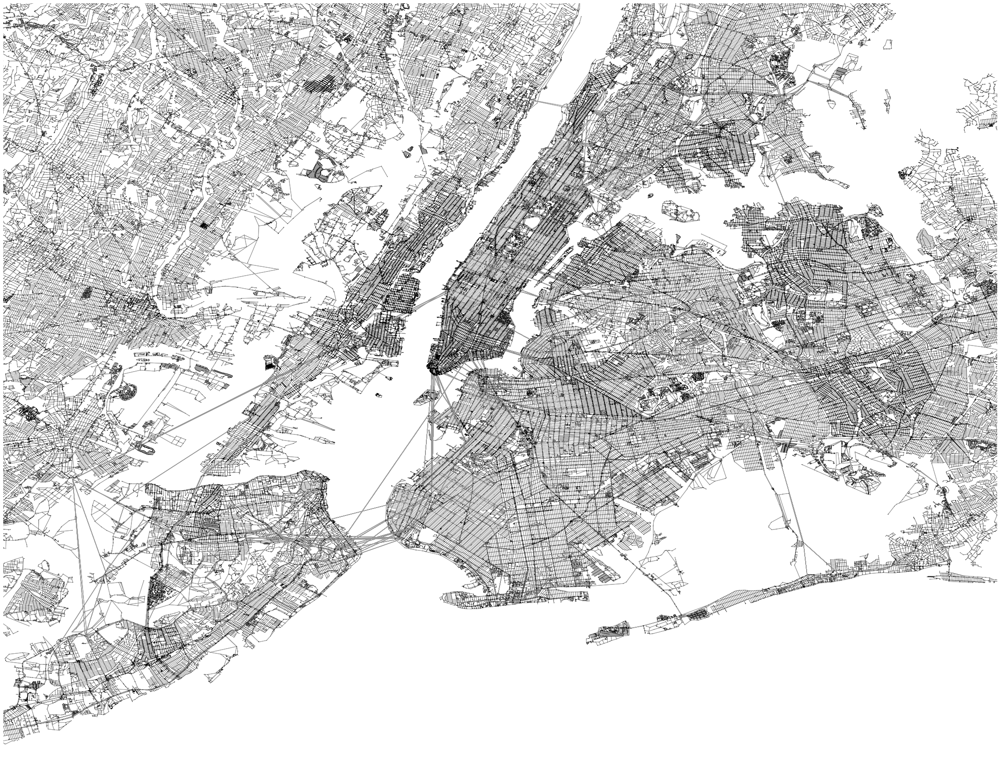

(<Figure size 2751.37x2160 with 1 Axes>, <AxesSubplot:>)

In [37]:
#Visualize pedestrian network
ua.plot.plot_net(nodes=urbanaccess_net.net_nodes,
                 edges=urbanaccess_net.net_edges,
                 bbox=(-74.25909,40.477399,-73.700181,40.916178),
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=1.1, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

Figure created. Took 96.15 seconds


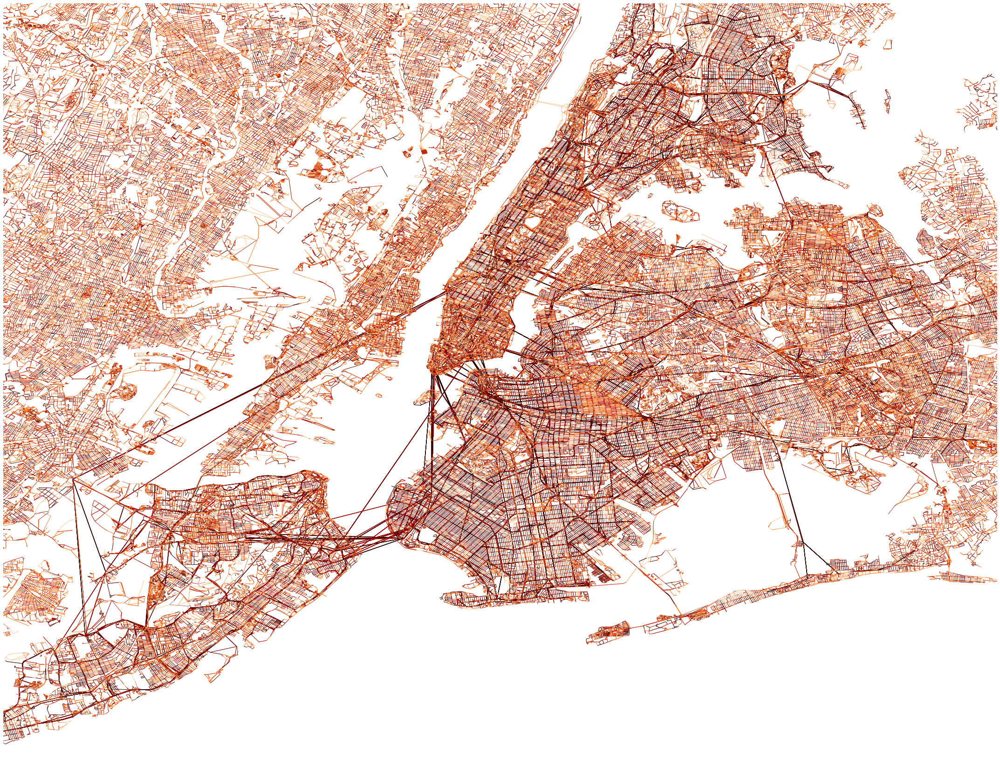

(<Figure size 2751.37x2160 with 1 Axes>, <AxesSubplot:>)

In [38]:
# Visualize integrated transit and pedestrian network
edgecolor = ua.plot.col_colors(df=urbanaccess_net.net_edges, col='weight', cmap='gist_heat_r', num_bins=5)
ua.plot.plot_net(nodes=urbanaccess_net.net_nodes,
                 edges=urbanaccess_net.net_edges,
                 bbox=(-74.25909,40.477399,-73.700181,40.916178),
                 fig_height=30, margin=0.02,
                 edge_color=edgecolor, edge_linewidth=1, edge_alpha=0.7,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

Figure created. Took 25.72 seconds


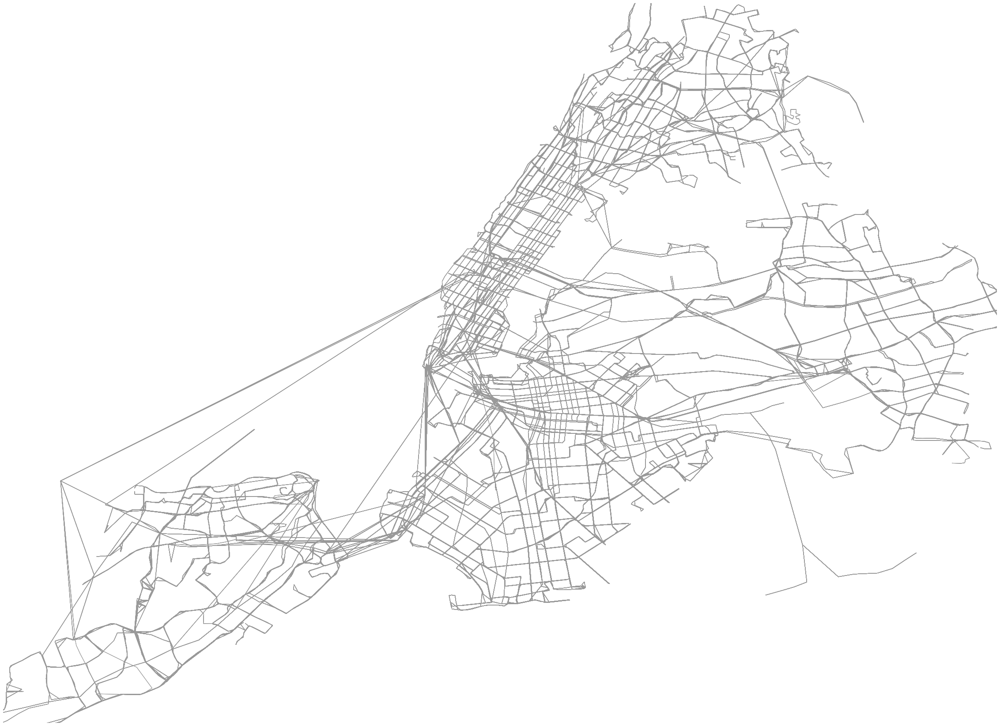

(<Figure size 2904.78x2160 with 1 Axes>, <AxesSubplot:>)

In [43]:
# Visualize the transit network including trains and buses, by network type (transit)
ua.plot.plot_net(nodes=urbanaccess_net.net_nodes,
                 edges=urbanaccess_net.net_edges[urbanaccess_net.net_edges['net_type']=='transit'],
                 bbox=None,
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

In [39]:
ua.gtfs.headways.headways(gtfsfeeds_df=loaded_feeds,
                          headway_timerange=['07:00:00','10:00:00'])

Stop times from 07:00:00 to 10:00:00 successfully selected 455,243 records out of 2,433,652 total records (18.71 percent of total). Took 1.04 seconds
Starting route stop headway calculation for 19,491 route stops...
Route stop headway calculation complete. Took 36.43 seconds
headway calculation complete. Took 42.79 seconds


In [40]:
loaded_feeds.headways.head()

,count,mean,std,min,25%,50%,75%,max,unique_stop_id,unique_route_id,node_id_route
911504,109.0,1.568807,3.356494,0.0,0.0,0.0,0.0,12.0,100014_mta_new_york_city_transit,BX26_mta_new_york_city_transit,100014_mta_new_york_city_transit_BX26_mta_new_...
911505,109.0,1.568807,3.356494,0.0,0.0,0.0,0.0,12.0,100014_mta_new_york_city_transit,BX26_mta_new_york_city_transit,100014_mta_new_york_city_transit_BX26_mta_new_...
911506,109.0,1.568807,3.356494,0.0,0.0,0.0,0.0,12.0,100014_mta_new_york_city_transit,BX26_mta_new_york_city_transit,100014_mta_new_york_city_transit_BX26_mta_new_...
911507,109.0,1.568807,3.356494,0.0,0.0,0.0,0.0,12.0,100014_mta_new_york_city_transit,BX26_mta_new_york_city_transit,100014_mta_new_york_city_transit_BX26_mta_new_...
911508,109.0,1.568807,3.356494,0.0,0.0,0.0,0.0,12.0,100014_mta_new_york_city_transit,BX26_mta_new_york_city_transit,100014_mta_new_york_city_transit_BX26_mta_new_...


In [41]:
ua.network.integrate_network(urbanaccess_network=urbanaccess_net,
                             headways=True,
                             urbanaccess_gtfsfeeds_df=loaded_feeds,
                             headway_statistic='mean')

Loaded UrbanAccess network components comprised of:
     Transit: 13,513 nodes and 440,063 edges;
     OSM: 403,317 nodes and 1,215,368 edges
routes successfully joined to transit nodes. Took 0.81 seconds
Connector edges between the OSM and transit network nodes successfully completed. Took 6.67 seconds
mean route stop headway will be used for pedestrian to transit edge impedance.
Headway impedance calculation completed. Took 1.12 seconds
Edge and node tables formatted for Pandana with integer node ids: id_int, to_int, and from_int. Took 37.52 seconds
Network edge and node network integration completed successfully resulting in a total of 422,808 nodes and 3,788,597 edges:
     Transit: 19,491 nodes 440,063 edges;
     OSM: 403,317 nodes 1,215,368 edges; and
     OSM/Transit connector: 2,133,166 edges.


Figure created. Took 227.48 seconds


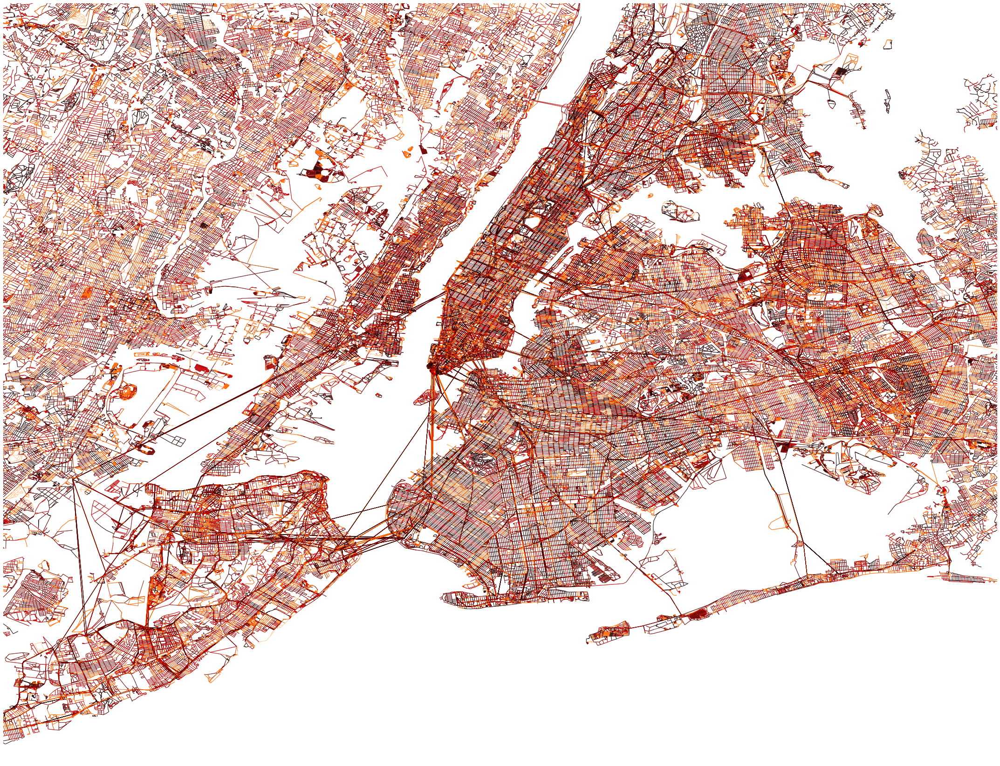

(<Figure size 2751.37x2160 with 1 Axes>, <AxesSubplot:>)

In [42]:
# Visualize integrated transit and pedestrian network, weighted by transit route frequency
edgecolor = ua.plot.col_colors(df=urbanaccess_net.net_edges, col='weight', cmap='gist_heat_r', num_bins=5)
ua.plot.plot_net(nodes=urbanaccess_net.net_nodes,
                 edges=urbanaccess_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color=edgecolor, edge_linewidth=1, edge_alpha=0.7,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

In [89]:
# Load NY state block data
nybg = pd.read_csv("NY_Blocks.csv")
nybg

,GEOID,ALAND20,AWATER20,x,y
0,360894925011010,0,21972,-75.182586,44.284402
1,360894926002022,113014,0,-75.216830,44.363189
2,360894926002034,50829,0,-75.239639,44.356982
3,360894926002029,397018,0,-75.224958,44.348747
4,360894926002010,58704,0,-75.198572,44.347600
...,...,...,...,...,...
288814,360290091091003,36854,0,-78.765500,42.990761
288815,360290080024000,12580,0,-78.852498,42.985665
288816,360290150021039,655048,0,-78.498732,42.748689
288817,360290154021007,0,15105,-78.970125,42.714141


In [94]:
nyjobs = pd.read_csv("NYC_Jobs.csv")
nyjobs

,GEOID,Jobs
0,360010001001008,19
1,360010001001009,15
2,360010001001010,10
3,360010001001011,51
4,360010001001012,38
...,...,...
231550,361231505004017,4
231551,361231505004019,6
231552,361231505004020,1
231553,361231505004021,2


In [97]:
df = pd.merge(nyjobs, 
              nybg,
              on=['GEOID','GEOID'])
df.head()

,GEOID,Jobs,ALAND20,AWATER20,x,y
0,360010001001008,19,7783,0,-73.736149,42.676900
1,360010001001009,15,6149,0,-73.737863,42.677447
2,360010001001010,10,37825,0,-73.740476,42.677820
3,360010001001011,51,16416,0,-73.741709,42.678003
4,360010001001012,38,12999,0,-73.739613,42.677171


In [98]:
# Convert dataframe into .h5 file
df = pd.DataFrame(df)
df.to_hdf('nycblocks.h5', key='df', mode='a')

In [99]:
blocks = pd.read_hdf('nycblocks.h5')
# remove blocks that contain all water
blocks = blocks[blocks['ALAND20'] != 0]
print('Total number of blocks: {:,}'.format(len(blocks)))
blocks.head()

Total number of blocks: 148,432


,GEOID,Jobs,ALAND20,AWATER20,x,y
0,360010001001008,19,7783,0,-73.736149,42.676900
1,360010001001009,15,6149,0,-73.737863,42.677447
2,360010001001010,10,37825,0,-73.740476,42.677820
3,360010001001011,51,16416,0,-73.741709,42.678003
4,360010001001012,38,12999,0,-73.739613,42.677171


In [100]:
lng_max, lat_min, lng_min, lat_max = bbox
outside_bbox = blocks.loc[~(((lng_max < blocks["x"]) & (blocks["x"] < lng_min)) & ((lat_min < blocks["y"]) & (blocks["y"] < lat_max)))]
blocks = blocks.drop(outside_bbox.index)
print('Total number of subset blocks: {:,}'.format(len(blocks)))

Total number of subset blocks: 28,358


<AxesSubplot:xlabel='x', ylabel='y'>

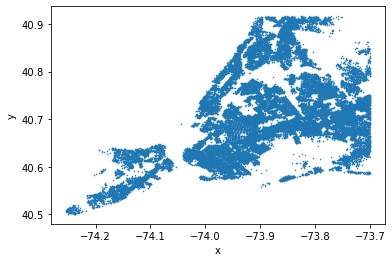

In [101]:
# Plot merged block dataframe
blocks.plot(kind='scatter', x='x', y='y', s=0.3)

In [103]:
# Initialize Pandana network using combined transit and pedestrian network
s_time = time.time()
transit_ped_net = pdna.Network(urbanaccess_net.net_nodes["x"],
                               urbanaccess_net.net_nodes["y"],
                               urbanaccess_net.net_edges["from_int"],
                               urbanaccess_net.net_edges["to_int"],
                               urbanaccess_net.net_edges[["weight"]], 
                               twoway=True)
print('Took {:,.2f} seconds'.format(time.time() - s_time))

Generating contraction hierarchies with 8 threads.
Setting CH node vector of size 422808
Setting CH edge vector of size 3788597
Range graph removed 6304476 edges of 7577194
. 10% . 20% . 30% . 40% . 50% . 60% . 70% . 80% . 90% . 100%
Took 46.89 seconds


In [104]:
# Set blocks onto network
blocks['node_id'] = transit_ped_net.get_node_ids(blocks['x'], blocks['y'])

In [105]:
transit_ped_net.set(blocks.node_id, variable = blocks.Jobs, name='Jobs')

In [106]:
s_time = time.time()
jobs_45 = transit_ped_net.aggregate(45, type='sum', decay='linear', name='Jobs')
jobs_30 = transit_ped_net.aggregate(30, type='sum', decay='linear', name='Jobs')
jobs_15 = transit_ped_net.aggregate(15, type='sum', decay='linear', name='Jobs')
print('Took {:,.2f} seconds'.format(time.time() - s_time))

Took 1,575.08 seconds


In [107]:
print(jobs_30)

id_int
1         198208.416811
2         175368.463487
3         315693.745675
4         314908.160651
5         347635.869061
              ...      
422804      2332.081280
422805      2492.003429
422806      2506.295022
422807      2618.433428
422808      2631.997514
Length: 422808, dtype: float64


Took 1.11 seconds


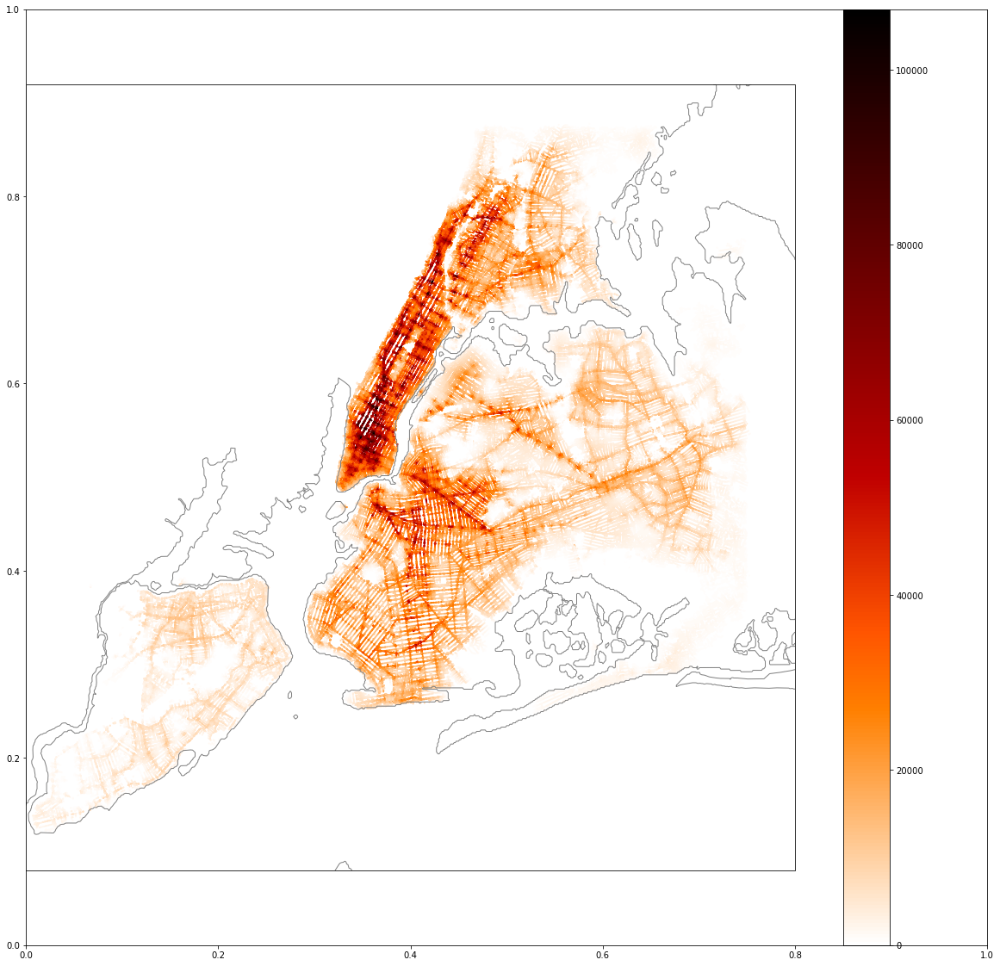

In [108]:
s_time = time.time()

fig = plt.subplots(figsize=(20,20))

data_crs = ccrs.PlateCarree()
ax = plt.axes(projection=ccrs.epsg(2263))
ax.add_feature(cartopy.feature.GSHHSFeature(scale='full'), edgecolor='grey')

plt.scatter(transit_ped_net.nodes_df.x, transit_ped_net.nodes_df.y, 
            c=jobs_15, s=4, cmap='gist_heat_r', edgecolor='none', transform=data_crs)
cb = plt.colorbar()

print('Took {:,.2f} seconds'.format(time.time() - s_time))

Took 0.89 seconds


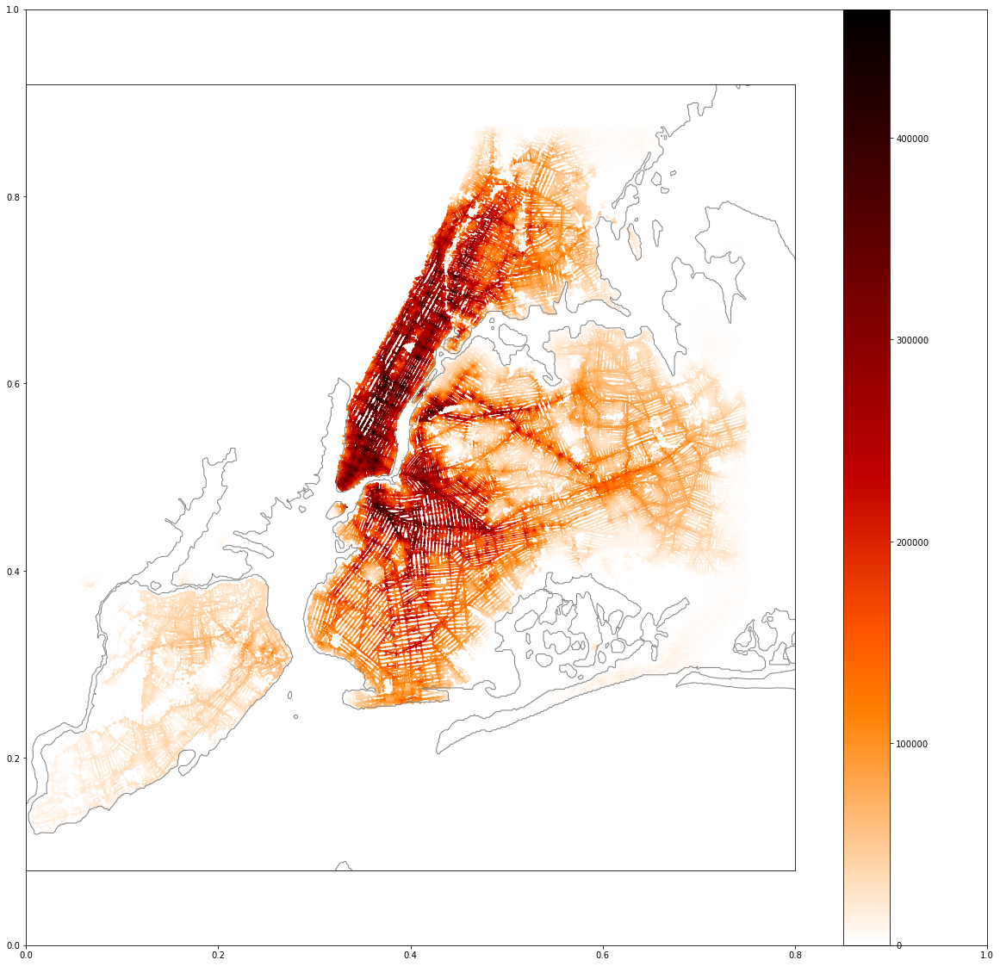

In [109]:
s_time = time.time()

fig = plt.subplots(figsize=(20,20))

data_crs = ccrs.PlateCarree()
ax = plt.axes(projection=ccrs.epsg(2263))
ax.add_feature(cartopy.feature.GSHHSFeature(scale='full'), edgecolor='grey')

plt.scatter(transit_ped_net.nodes_df.x, transit_ped_net.nodes_df.y, 
            c=jobs_30, s=4, cmap='gist_heat_r', edgecolor='none', transform=data_crs)
cb = plt.colorbar()

print('Took {:,.2f} seconds'.format(time.time() - s_time))

Took 0.72 seconds


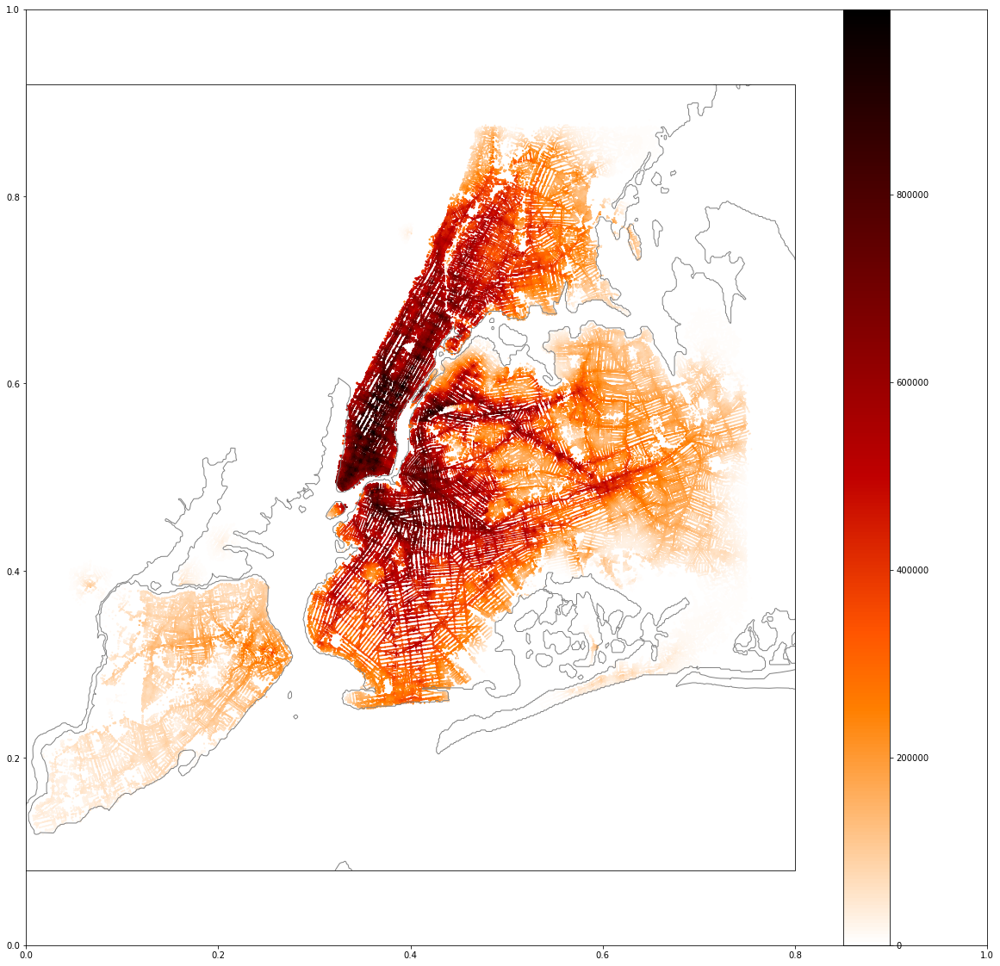

In [110]:
s_time = time.time()

fig = plt.subplots(figsize=(20,20))

data_crs = ccrs.PlateCarree()
ax = plt.axes(projection=ccrs.epsg(2263))
ax.add_feature(cartopy.feature.GSHHSFeature(scale='full'), edgecolor='grey')

plt.scatter(transit_ped_net.nodes_df.x, transit_ped_net.nodes_df.y, 
            c=jobs_45, s=4, cmap='gist_heat_r', edgecolor='none', transform=data_crs)
cb = plt.colorbar()

print('Took {:,.2f} seconds'.format(time.time() - s_time))